## Imports

In [30]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as sps

import tempfile
import random
import operator
import os
import sys
import gc
import git
from time import time
from functools import partial
from pathlib import Path

import datetime
import time
from datetime import datetime, timedelta

from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error
from sklearn.base import BaseEstimator
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb

from mlforecast import MLForecast
from mlforecast.distributed import DistributedMLForecast
from mlforecast.lag_transforms import ExpandingMean, ExponentiallyWeightedMean, RollingMean
from mlforecast.target_transforms import Differences, LocalStandardScaler
from mlforecast.utils import generate_daily_series, generate_prices_for_series, PredictionIntervals

from utilsforecast.losses import mse, rmse, mae, mape, mase, smape
from utilsforecast.plotting import plot_series
from utilsforecast.evaluation import evaluate
from utilsforecast.feature_engineering import pipeline, trend, fourier

from datasetsforecast.m4 import M4, M4Info

from numba import njit
from window_ops.rolling import rolling_mean

import matplotlib.ticker as ticker
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

from statsmodels.tsa.stattools import adfuller
import statsmodels.api as sm
import statsmodels.tsa.api as smt
from statsmodels.tsa.seasonal import seasonal_decompose 

In [2]:
sns.set(font_scale=1.2, palette='Set2')

plt.rcParams['font.family'] = 'DejaVu Serif'
plt.rcParams['lines.linewidth'] = 2
plt.rcParams['lines.markersize'] = 12
plt.rcParams['xtick.labelsize'] = 24
plt.rcParams['ytick.labelsize'] = 24
plt.rcParams['legend.fontsize'] = 24
plt.rcParams['axes.titlesize'] = 30
plt.rcParams['axes.labelsize'] = 24
plt.rcParams["figure.figsize"] = (14, 8)

plt.style.use('ggplot')

## Quickstart

In [6]:
df = pd.read_csv('https://datasets-nixtla.s3.amazonaws.com/air-passengers.csv', parse_dates=['ds'])
print(df.shape)
df.head()

(144, 3)


,unique_id,ds,y
0,AirPassengers,1949-01-01,112
1,AirPassengers,1949-02-01,118
2,AirPassengers,1949-03-01,132
3,AirPassengers,1949-04-01,129
4,AirPassengers,1949-05-01,121


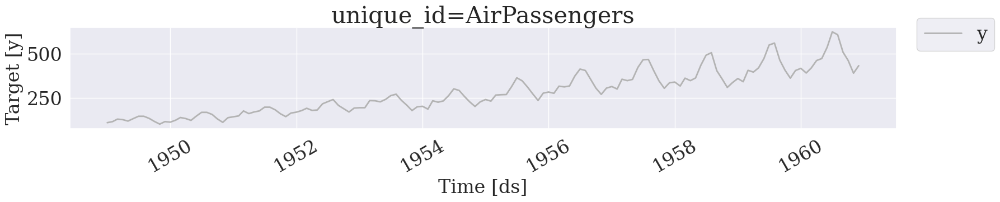

In [8]:
fig = plot_series(df)
fig

In [10]:
fcst = MLForecast(
    models=LinearRegression(),
    freq='MS',
    lags=[12],
    target_transforms=[Differences([1])],
)
fcst.fit(df)

MLForecast(models=[LinearRegression], freq=MS, lag_features=['lag12'], date_features=[], num_threads=1)

In [11]:
preds = fcst.predict(12)
preds

,unique_id,ds,LinearRegression
0,AirPassengers,1961-01-01,444.656555
1,AirPassengers,1961-02-01,417.470764
2,AirPassengers,1961-03-01,446.903076
3,AirPassengers,1961-04-01,491.014160
4,AirPassengers,1961-05-01,502.622253
5,AirPassengers,1961-06-01,568.751465
6,AirPassengers,1961-07-01,660.044312
7,AirPassengers,1961-08-01,643.343323
8,AirPassengers,1961-09-01,540.666748
9,AirPassengers,1961-10-01,491.462799


In [13]:
plot_series(df, preds, engine='plotly')

## Spark example

In [3]:
%%writefile temp.sh
export PYSPARK_PYTHON='/home/eduard/mambaforge/envs/mix/bin/python'

Writing temp.sh


In [4]:
!chmod +x temp.sh
!source ./temp.sh
os.remove('temp.sh')

In [5]:
os.environ['PYSPARK_PYTHON'] = sys.executable

In [7]:
from pyspark.sql import SparkSession


spark = (
    SparkSession
    .builder
    .getOrCreate()
)

25/03/20 16:33:38 WARN Utils: Your hostname, eduard-Vector-GP66 resolves to a loopback address: 127.0.1.1; using 192.168.13.191 instead (on interface wlo1)
25/03/20 16:33:38 WARN Utils: Set SPARK_LOCAL_IP if you need to bind to another address
Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).
25/03/20 16:33:39 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable


In [8]:
series = generate_daily_series(100, n_static_features=2, equal_ends=True, static_as_categorical=False, min_length=500, max_length=1_000)
series['unique_id'] = series['unique_id'].astype(str)  # can't handle categoricals atm
train, future = fourier(series, freq='d', season_length=7, k=2, h=7)
numPartitions = 4
spark_series = spark.createDataFrame(train).repartitionByRange(numPartitions, 'unique_id')

In [9]:
from mlforecast.distributed.models.spark.xgb import SparkXGBForecast


models = [
    SparkXGBForecast(random_state=0),
]

In [10]:
fcst = DistributedMLForecast(
    models,
    freq='D',
    target_transforms=[Differences([7])],    
    lags=[1],
    lag_transforms={
        1: [ExpandingMean(), ExponentiallyWeightedMean(alpha=0.9)],
    },
    date_features=['dayofweek'],
)
fcst.fit(
    spark_series,
    static_features=['static_0', 'static_1'],
)

INFO:root:Persist dataframe with Disk Memory Serialized 1x Replicated, count 4  
INFO:XGBoost-PySpark:Running xgboost-2.1.2 on 1 workers with
	booster params: {'objective': 'reg:squarederror', 'device': 'cpu', 'random_state': 0, 'nthread': 1}
	train_call_kwargs_params: {'verbose_eval': True, 'num_boost_round': 100}
	dmatrix_kwargs: {'nthread': 1, 'missing': nan}
2025-03-20 16:33:52,610 INFO XGBoost-PySpark: _train_booster Training on CPUs
[16:33:53] Task 0 got rank 0                                        (0 + 1) / 1]
INFO:XGBoost-PySpark:Finished xgboost training!                                 


DistributedMLForecast(models=[SparkXGBForecast], freq=D, lag_features=['lag1', 'expanding_mean_lag1', 'exponentially_weighted_mean_lag1_alpha0_9'], date_features=['dayofweek'], num_threads=1, engine=None)

In [11]:
preds = fcst.predict(7, X_df=future).toPandas()
preds.head()

,unique_id,ds,SparkXGBForecast
0,id_00,2002-09-27,15.273368
1,id_00,2002-09-28,93.368532
2,id_00,2002-09-29,159.520877
3,id_00,2002-09-30,251.705932
4,id_00,2002-10-01,324.511122


In [17]:
def build_unique_name(engine):
    pyver = f'{sys.version_info.major}_{sys.version_info.minor}'
    repo = git.Repo(search_parent_directories=True)
    sha = repo.head.object.hexsha
    return f'{sys.platform}-{pyver}-{engine}-{sha}'

In [21]:
save_dir = build_unique_name('spark')
save_path = f's3://nixtla-tmp/mlf/{save_dir}'
tmpdir = tempfile.TemporaryDirectory()

try:
    s3fs.S3FileSystem().ls('s3://nixtla-tmp/')
    fcst.save(save_path)
except Exception as e:
    print(e)
    save_path = f'{tmpdir.name}/{save_dir}'
    fcst.save(save_path)

name 's3fs' is not defined


## End-to-end

In [23]:
await M4.async_download('data', group='Hourly')
df, *_ = M4.load('data', 'Hourly')
uids = df['unique_id'].unique()
random.seed(0)
sample_uids = random.choices(uids, k=4)
df = df[df['unique_id'].isin(sample_uids)].reset_index(drop=True)
df['ds'] = df['ds'].astype('int64')
df

,unique_id,ds,y
0,H196,1,11.8
1,H196,2,11.4
2,H196,3,11.1
3,H196,4,10.8
4,H196,5,10.6
...,...,...,...
4027,H413,1004,99.0
4028,H413,1005,88.0
4029,H413,1006,47.0
4030,H413,1007,41.0


In [27]:
plot_series(df, max_insample_length=24 * 14, engine='plotly')

In [28]:
fcst = MLForecast(
    models=[],  # we're not interested in modeling yet
    freq=1,  # our series have integer timestamps, so we'll just add 1 in every timestep
    target_transforms=[Differences([24])],
)
prep = fcst.preprocess(df)
prep

,unique_id,ds,y
24,H196,25,0.3
25,H196,26,0.3
26,H196,27,0.1
27,H196,28,0.2
28,H196,29,0.2
...,...,...,...
4027,H413,1004,39.0
4028,H413,1005,55.0
4029,H413,1006,14.0
4030,H413,1007,3.0


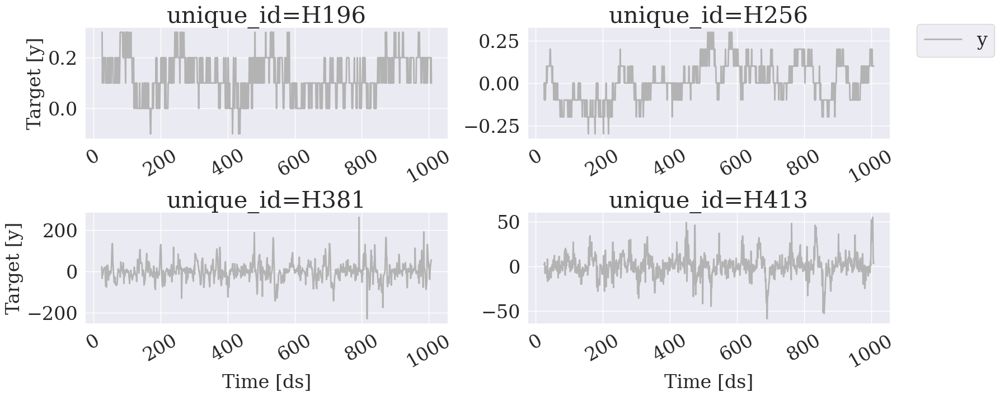

In [29]:
plot_series(prep)

Lags

In [30]:
fcst = MLForecast(
    models=[],
    freq=1,
    lags=[1, 24],
    target_transforms=[Differences([24])],    
)
prep = fcst.preprocess(df)
prep

,unique_id,ds,y,lag1,lag24
48,H196,49,0.1,0.1,0.3
49,H196,50,0.1,0.1,0.3
50,H196,51,0.2,0.1,0.1
51,H196,52,0.1,0.2,0.2
52,H196,53,0.1,0.1,0.2
...,...,...,...,...,...
4027,H413,1004,39.0,29.0,1.0
4028,H413,1005,55.0,39.0,-25.0
4029,H413,1006,14.0,55.0,-20.0
4030,H413,1007,3.0,14.0,0.0


In [31]:
prep.drop(columns=['unique_id', 'ds']).corr()['y']

y        1.000000
lag1     0.622531
lag24   -0.234268
Name: y, dtype: float64

Lag transforms

In [35]:
@njit
def rolling_mean_48(x):
    return rolling_mean(x, window_size=48)


fcst = MLForecast(
    models=[],
    freq=1,
    target_transforms=[Differences([24])],    
    lag_transforms={
        1: [ExpandingMean()],
        24: [RollingMean(window_size=48), rolling_mean_48],
    },
)
prep = fcst.preprocess(df)
prep

,unique_id,ds,y,expanding_mean_lag1,rolling_mean_lag24_window_size48,rolling_mean_48_lag24
95,H196,96,0.1,0.174648,0.150000,0.150000
96,H196,97,0.3,0.173611,0.145833,0.145833
97,H196,98,0.3,0.175342,0.141667,0.141667
98,H196,99,0.3,0.177027,0.141667,0.141667
99,H196,100,0.3,0.178667,0.141667,0.141667
...,...,...,...,...,...,...
4027,H413,1004,39.0,0.242084,3.437500,3.437500
4028,H413,1005,55.0,0.281633,2.708333,2.708333
4029,H413,1006,14.0,0.337411,2.125000,2.125000
4030,H413,1007,3.0,0.351324,1.770833,1.770833


Date features

In [36]:
def hour_index(times):
    return times % 24

fcst = MLForecast(
    models=[],
    freq=1,
    target_transforms=[Differences([24])],
    date_features=[hour_index],
)
fcst.preprocess(df)

,unique_id,ds,y,hour_index
24,H196,25,0.3,1
25,H196,26,0.3,2
26,H196,27,0.1,3
27,H196,28,0.2,4
28,H196,29,0.2,5
...,...,...,...,...
4027,H413,1004,39.0,20
4028,H413,1005,55.0,21
4029,H413,1006,14.0,22
4030,H413,1007,3.0,23


Target transforms

In [ ]:
fcst = MLForecast(
    models=[],
    freq=1,
    lags=[1],
    target_transforms=[LocalStandardScaler()]
)
fcst.preprocess(df)

In [41]:
from sklearn.base import BaseEstimator

class Naive(BaseEstimator):
    def fit(self, X, y):
        return self

    def predict(self, X):
        return X['lag1']

In [42]:
fcst = MLForecast(
    models=[Naive()],
    freq=1,
    lags=[1],
    target_transforms=[LocalStandardScaler()]
)
fcst.fit(df)
preds = fcst.predict(1)
preds

,unique_id,ds,Naive
0,H196,1009,16.8
1,H256,1009,13.4
2,H381,1009,207.0
3,H413,1009,34.0


## Training

In [50]:
from catboost import CatBoostRegressor


cb_params = {
    'verbose': False,
    'iterations': 200,
}

fcst = MLForecast(
    models={
        'avg': CatBoostRegressor(**cb_params),
        'q75': CatBoostRegressor(**cb_params, loss_function='Quantile:alpha=0.75'),
        'q25': CatBoostRegressor(**cb_params, loss_function='Quantile:alpha=0.25'),
    },
    freq=1,
    target_transforms=[Differences([24])],
    lags=[1, 24],
    lag_transforms={
        1: [ExpandingMean()],
        24: [RollingMean(window_size=48)],
    },
    date_features=[hour_index],
)
fcst.fit(df)

MLForecast(models=[avg, q75, q25], freq=1, lag_features=['lag1', 'lag24', 'expanding_mean_lag1', 'rolling_mean_lag24_window_size48'], date_features=[<function hour_index at 0x7c509eacdf70>], num_threads=1)

In [51]:
preds = fcst.predict(48)
preds

,unique_id,ds,avg,q75,q25
0,H196,1009,16.611882,16.346398,16.282104
1,H196,1010,16.500800,15.950695,15.881314
2,H196,1011,16.073964,15.796265,15.680845
3,H196,1012,15.785791,15.495679,15.381003
4,H196,1013,15.255869,15.096031,14.981071
...,...,...,...,...,...
187,H413,1052,93.613731,165.739203,42.183388
188,H413,1053,76.965790,155.261112,26.807931
189,H413,1054,43.290917,123.495470,-12.826314
190,H413,1055,51.438694,123.667326,-11.496664


In [53]:
plot_series(df, preds, max_insample_length=24 * 7, engine='plotly')

Save and Load

In [54]:
with tempfile.TemporaryDirectory() as tmpdir:
    save_dir = Path(tmpdir) / 'mlforecast'
    fcst.save(save_dir)
    fcst2 = MLForecast.load(save_dir)
    preds2 = fcst2.predict(48)
    pd.testing.assert_frame_equal(preds, preds2)

Update values

In [55]:
fcst = MLForecast(
    models=[Naive()],
    freq=1,
    lags=[1, 2, 3],
)
fcst.fit(df)
fcst.predict(1)

,unique_id,ds,Naive
0,H196,1009,16.8
1,H256,1009,13.4
2,H381,1009,207.0
3,H413,1009,34.0


In [56]:
new_values = pd.DataFrame({
    'unique_id': ['H196', 'H256'],
    'ds': [1009, 1009],
    'y': [17.0, 14.0],
})
fcst.update(new_values)
preds = fcst.predict(1)
preds

,unique_id,ds,Naive
0,H196,1010,17.0
1,H256,1010,14.0
2,H381,1009,207.0
3,H413,1009,34.0


Cross-validation

In [58]:
fcst = MLForecast(
    models=CatBoostRegressor(**cb_params),
    freq=1,
    target_transforms=[Differences([24])],
    lags=[1, 24],
    lag_transforms={
        1: [ExpandingMean()],
        24: [RollingMean(window_size=48)],
    },
    date_features=[hour_index],
)
cv_result = fcst.cross_validation(
    df,
    n_windows=4,  # number of models to train/splits to perform
    h=48,  # length of the validation set in each window
)
cv_result

,unique_id,ds,cutoff,y,CatBoostRegressor
0,H196,817,816,15.3,15.375835
1,H196,818,816,14.9,15.125730
2,H196,819,816,14.6,14.918995
3,H196,820,816,14.2,14.515738
4,H196,821,816,13.9,14.257007
...,...,...,...,...,...
763,H413,1004,960,99.0,61.709299
764,H413,1005,960,88.0,59.679963
765,H413,1006,960,47.0,54.528058
766,H413,1007,960,41.0,42.900262


In [69]:
plot_series(forecasts_df=cv_result.drop(columns='cutoff'), engine='plotly', palette='Accent')

In [71]:
def evaluate_cv(df):
    return rmse(df, models=['CatBoostRegressor'], id_col='cutoff').set_index('cutoff')

split_rmse = evaluate_cv(cv_result)
split_rmse

,CatBoostRegressor
cutoff,
816,39.843562
864,34.998921
912,13.158283
960,34.326952


In [82]:
from mlforecast.lgb_cv import LightGBMCV


lgb_params = {
    'verbosity': -1,
    'num_leaves': 512,
}

cv = LightGBMCV(
    freq=1,
    target_transforms=[Differences([24])],
    lags=[1, 24],
    lag_transforms={
        1: [ExpandingMean()],
        24: [RollingMean(window_size=48)],
    },
    date_features=[hour_index],
    num_threads=2,
)
cv_hist = cv.fit(
    df,
    n_windows=4,
    h=48,
    params=lgb_params,
    eval_every=5,
    early_stopping_evals=5,    
    compute_cv_preds=True,
)

[5] mape: 0.158639
[10] mape: 0.163739
[15] mape: 0.161535
[20] mape: 0.169491
[25] mape: 0.163690
[30] mape: 0.164198
Early stopping at round 30
Using best iteration: 5


In [83]:
cv.cv_preds_


,unique_id,ds,y,Booster,window
0,H196,817,15.3,15.473182,0
1,H196,818,14.9,15.038571,0
2,H196,819,14.6,14.849409,0
3,H196,820,14.2,14.448379,0
4,H196,821,13.9,14.148379,0
...,...,...,...,...,...
187,H413,1004,99.0,61.425396,3
188,H413,1005,88.0,62.886890,3
189,H413,1006,47.0,57.886890,3
190,H413,1007,41.0,38.849009,3


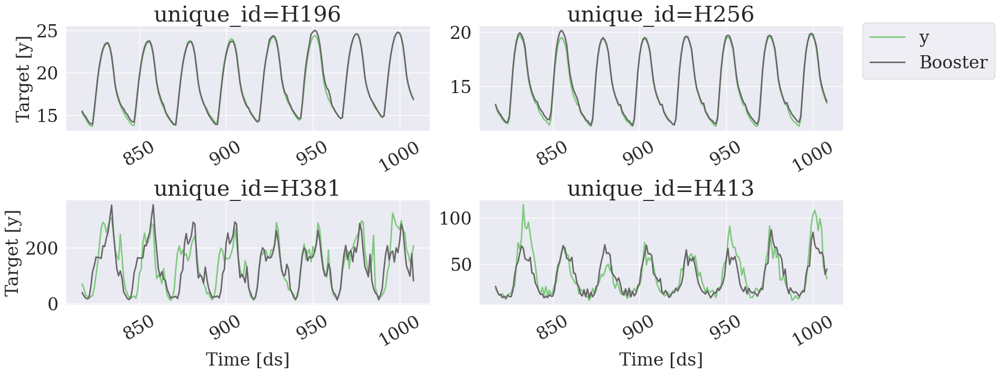

In [85]:
plot_series(forecasts_df=cv.cv_preds_.drop(columns='window'), palette='Accent')

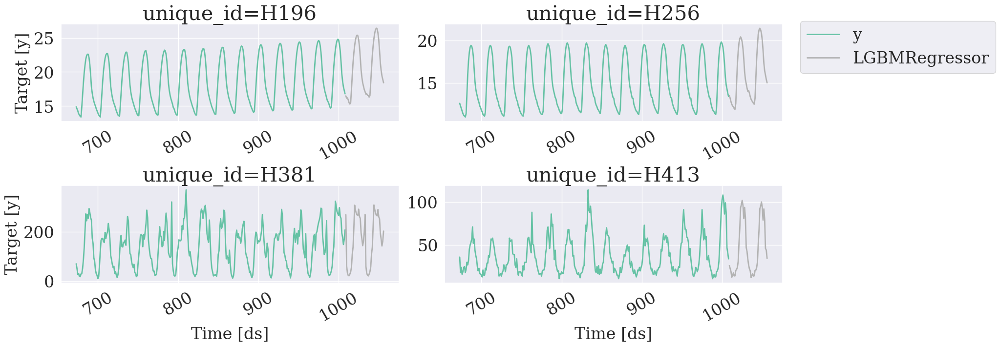

In [87]:
final_fcst = MLForecast.from_cv(cv)
final_fcst.fit(df)
preds = final_fcst.predict(48)
fig = plot_series(df, preds, max_insample_length=24 * 14)
fig

## Electricity Load Forecast

In [89]:
pd.plotting.register_matplotlib_converters()


data_url = 'https://raw.githubusercontent.com/panambY/Hourly_Energy_Consumption/master/data/PJM_Load_hourly.csv'
df = pd.read_csv(data_url, parse_dates=['Datetime'])
df.columns = ['ds', 'y']
df.insert(0, 'unique_id', 'PJM_Load_hourly')
df['ds'] = pd.to_datetime(df['ds'])
df = df.sort_values(['unique_id', 'ds']).reset_index(drop=True)
print(f'Shape of the data {df.shape}')
df.tail()

Shape of the data (32896, 3)


,unique_id,ds,y
32891,PJM_Load_hourly,2001-12-31 20:00:00,36392.0
32892,PJM_Load_hourly,2001-12-31 21:00:00,35082.0
32893,PJM_Load_hourly,2001-12-31 22:00:00,33890.0
32894,PJM_Load_hourly,2001-12-31 23:00:00,32590.0
32895,PJM_Load_hourly,2002-01-01 00:00:00,31569.0


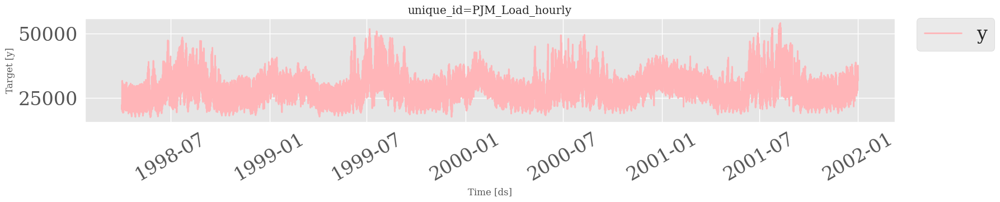

In [94]:
fig = plot_series(df)
fig

In [95]:
threshold_time = df['ds'].max() - pd.Timedelta(hours=24)

# Split the dataframe
df_train = df[df['ds'] <= threshold_time]
df_last_24_hours = df[df['ds'] > threshold_time]

Analyze seasonalities

In [105]:
def plot_differences(df, differences):
    prep = [df]
    # Plot individual Differences
    for d in differences:
        fcst = MLForecast(
        models=[],  # we're not interested in modeling yet
        freq='H',  # our series have hourly frequency 
        target_transforms=[Differences([d])],
        )
        df_ = fcst.preprocess(df)
        df_['unique_id'] = df_['unique_id'] + f'_{d}'
        prep.append(df_)
        
    # Plot combined Differences
    fcst = MLForecast(
    models=[],  # we're not interested in modeling yet
    freq='H',  # our series have hourly frequency 
    target_transforms=[Differences([24, 24*7])],
    )
    df_ = fcst.preprocess(df)
    df_['unique_id'] = df_['unique_id'] + f'_all_diff'
    prep.append(df_)
    prep = pd.concat(prep, ignore_index=True)
    #return prep
    n_series = len(prep['unique_id'].unique())
    fig, ax = plt.subplots(nrows=n_series, figsize=(7 * n_series, 10*n_series), squeeze=False)
    for title, axi in zip(prep['unique_id'].unique(), ax.flat):
        df_ = prep[prep['unique_id'] == title]
        df_.set_index('ds')['y'].plot(title=title, ax=axi)


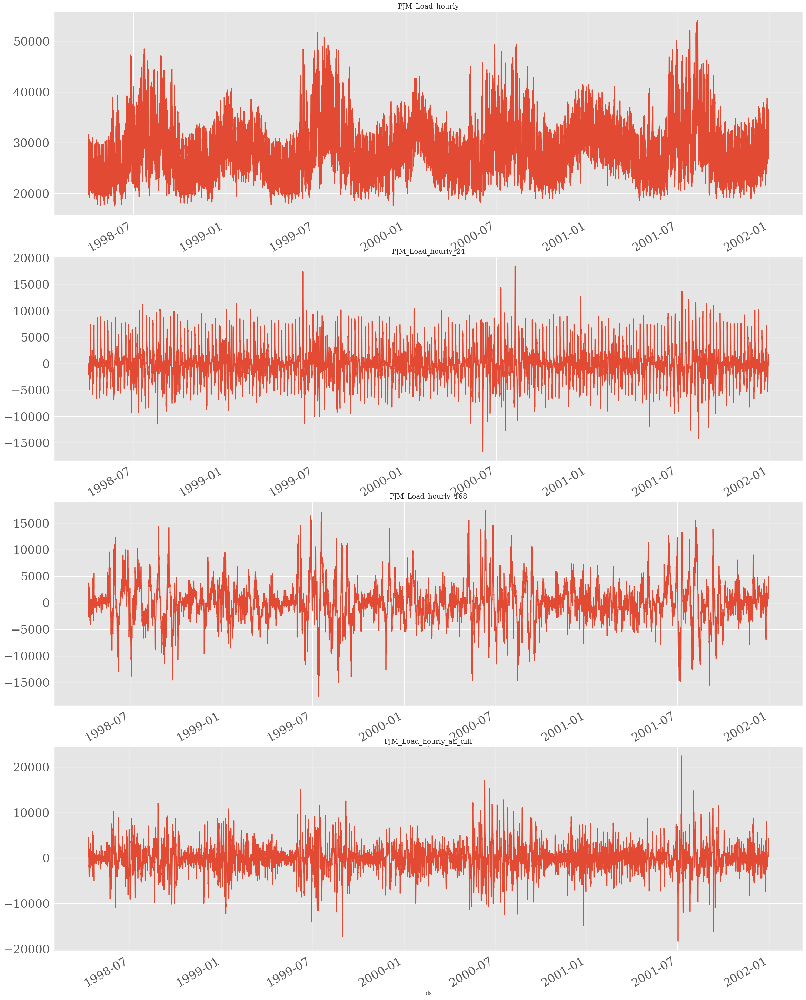

In [106]:
plot_differences(df=df_train, differences=[24, 24*7])

In [110]:
df_train.head(10)

,unique_id,ds,y
0,PJM_Load_hourly,1998-04-01 01:00:00,22259.0
1,PJM_Load_hourly,1998-04-01 02:00:00,21244.0
2,PJM_Load_hourly,1998-04-01 03:00:00,20651.0
3,PJM_Load_hourly,1998-04-01 04:00:00,20421.0
4,PJM_Load_hourly,1998-04-01 05:00:00,20713.0
5,PJM_Load_hourly,1998-04-01 06:00:00,22526.0
6,PJM_Load_hourly,1998-04-01 07:00:00,25772.0
7,PJM_Load_hourly,1998-04-01 08:00:00,28724.0
8,PJM_Load_hourly,1998-04-01 09:00:00,30075.0
9,PJM_Load_hourly,1998-04-01 10:00:00,30689.0


In [117]:
fcst = MLForecast(
    models=[],  # we're not interested in modeling yet
    freq='H',  # our series have hourly frequency 
    target_transforms=[Differences([24, 24*7])],
)
prep = fcst.preprocess(df_train)
prep

,unique_id,ds,y
192,PJM_Load_hourly,1998-04-09 02:00:00,831.0
193,PJM_Load_hourly,1998-04-09 03:00:00,918.0
194,PJM_Load_hourly,1998-04-09 04:00:00,760.0
195,PJM_Load_hourly,1998-04-09 05:00:00,849.0
196,PJM_Load_hourly,1998-04-09 06:00:00,710.0
...,...,...,...
32867,PJM_Load_hourly,2001-12-30 20:00:00,3417.0
32868,PJM_Load_hourly,2001-12-30 21:00:00,3596.0
32869,PJM_Load_hourly,2001-12-30 22:00:00,3501.0
32870,PJM_Load_hourly,2001-12-30 23:00:00,3939.0


Model selection with cross-validation

In [119]:
class Naive(BaseEstimator):
    def fit(self, X, y):
        return self

    def predict(self, X):
        return X['lag1']

In [123]:
# Model dictionary
models ={
    'naive': Naive(),
    'lasso': Lasso(),
    'lin_reg': LinearRegression(),
    'ridge': Ridge(),
    'knn': KNeighborsRegressor(),
    'mlp': MLPRegressor(), 
    'rf': RandomForestRegressor(),
    'catboost': CatBoostRegressor(verbose=False)
}

In [124]:
mlf = MLForecast(
    models = models, 
    freq='H',  # our series have hourly frequency 
    target_transforms=[Differences([24, 24*7])],
    lags=[1,12,24], # Lags to be used as features
    lag_transforms={  
        1: [ExpandingMean()],
        24: [RollingMean(window_size=48)],
    },
    date_features=['month', 'hour', 'dayofweek']
)

In [127]:
crossvalidation_df = mlf.cross_validation(
    df=df_train,
    h=24,
    n_windows=4,
    refit=False,
)
crossvalidation_df.head()

,unique_id,ds,cutoff,y,naive,lasso,lin_reg,ridge,knn,mlp,rf,catboost
0,PJM_Load_hourly,2001-12-27 01:00:00,2001-12-27,28332.0,28837.0,28703.185712,28702.625949,28702.625956,28479.0,28746.579946,28094.12,28212.968337
1,PJM_Load_hourly,2001-12-27 02:00:00,2001-12-27,27329.0,27969.0,27693.502318,27692.395954,27692.395969,27521.6,27763.103104,27061.45,26953.638538
2,PJM_Load_hourly,2001-12-27 03:00:00,2001-12-27,26986.0,27435.0,26991.795124,26990.157567,26990.157589,26451.6,27055.538722,26311.30,26044.664020
3,PJM_Load_hourly,2001-12-27 04:00:00,2001-12-27,27009.0,27401.0,26789.418399,26787.262262,26787.262291,26388.4,26834.768343,26291.03,25716.452818
4,PJM_Load_hourly,2001-12-27 05:00:00,2001-12-27,27555.0,28169.0,27369.643789,27366.983075,27366.983111,26779.6,27414.416674,27006.09,26174.572750


In [130]:
def plot_cv(df, df_cv, uid, last_n=24 * 14, models={}):
    cutoffs = df_cv.query('unique_id == @uid')['cutoff'].unique()
    fig, ax = plt.subplots(nrows=len(cutoffs), ncols=1, figsize=(14, 14), gridspec_kw=dict(hspace=0.8))
    for cutoff, axi in zip(cutoffs, ax.flat):
        max_date = df_cv.query('unique_id == @uid & cutoff == @cutoff')['ds'].max()
        df[df['ds'] < max_date].query('unique_id == @uid').tail(last_n).set_index('ds').plot(ax=axi, title=uid, y='y')
        for m in models.keys():
            df_cv.query('unique_id == @uid & cutoff == @cutoff').set_index('ds').plot(ax=axi, title=uid, y=m)          


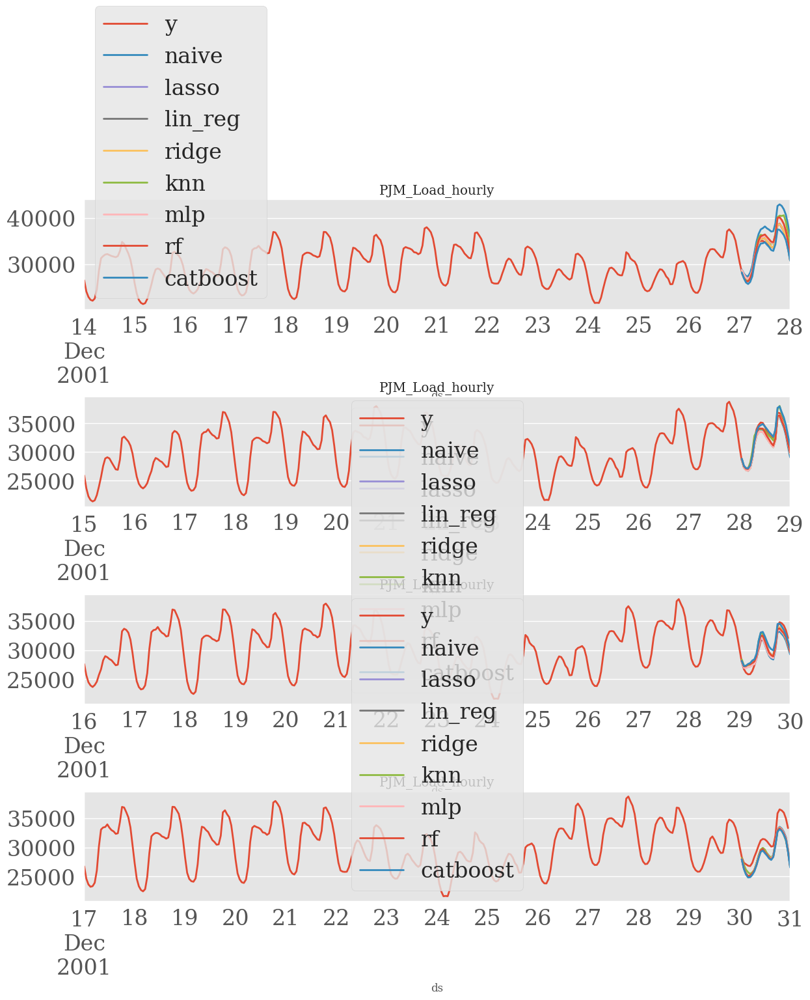

In [131]:
plot_cv(df_train, crossvalidation_df, 'PJM_Load_hourly', models=models)


In [132]:
metrics = [
    mae,
    rmse,
    mape,
    smape
]

def evaluate_crossvalidation(crossvalidation_df, metrics, models):
    evaluations = []
    for c in crossvalidation_df['cutoff'].unique():
        df_cv = crossvalidation_df.query('cutoff == @c')
        evaluation = evaluate(
            df = df_cv,
            metrics=metrics,
            models=list(models.keys())
            )
        evaluations.append(evaluation)
    evaluations = pd.concat(evaluations, ignore_index=True).drop(columns='unique_id')
    evaluations = evaluations.groupby('metric').mean()
    return evaluations.style.background_gradient(cmap='RdYlGn_r', axis=1)

In [133]:
evaluate_crossvalidation(crossvalidation_df, metrics, models)

,naive,lasso,lin_reg,ridge,knn,mlp,rf,catboost
metric,,,,,,,,
mae,1631.395833,1003.796433,1007.998597,1007.998547,1248.145833,1176.542303,1186.450521,1163.310190
mape,0.049759,0.031760,0.031888,0.031888,0.038721,0.036645,0.037107,0.037167
rmse,1871.398919,1148.616156,1153.262719,1153.262664,1451.964390,1327.355426,1332.117159,1316.645162
smape,0.024786,0.016269,0.016338,0.016338,0.019549,0.018712,0.018896,0.019003


Test Evaluation

In [135]:
models_evaluation ={
    'ridge': Ridge(),
    'lasso': Lasso(),
}

mlf_evaluation = MLForecast(
    models = models_evaluation, 
    freq='H',  # our series have hourly frequency 
    target_transforms=[Differences([24, 24*7])],
    lags=[1,12,24], 
    lag_transforms={  
        1: [ExpandingMean()],
        24: [RollingMean(window_size=48)],
    },
    date_features=['month', 'hour', 'dayofweek']
)

In [138]:
mlf_evaluation.fit(
    df = df_train,
    prediction_intervals=PredictionIntervals(n_windows=4, h=24)
)

MLForecast(models=[ridge, lasso], freq=H, lag_features=['lag1', 'lag12', 'lag24', 'expanding_mean_lag1', 'rolling_mean_lag24_window_size48'], date_features=['month', 'hour', 'dayofweek'], num_threads=1)

In [139]:
levels = [90, 95] # Levels for prediction intervals
forecasts = mlf_evaluation.predict(24, level=levels)
forecasts.head()

,unique_id,ds,ridge,lasso,ridge-lo-95,ridge-lo-90,ridge-hi-90,ridge-hi-95,lasso-lo-95,lasso-lo-90,lasso-hi-90,lasso-hi-95
0,PJM_Load_hourly,2001-12-31 01:00:00,29123.656762,29124.085976,28762.601162,28772.171519,29475.142005,29484.712361,28762.752269,28772.604275,29475.567677,29485.419682
1,PJM_Load_hourly,2001-12-31 02:00:00,28364.492155,28365.330749,27526.293102,27617.476643,29111.507668,29202.691209,27528.548959,27619.065224,29111.596275,29202.112539
2,PJM_Load_hourly,2001-12-31 03:00:00,27710.933072,27712.161676,26233.614718,26335.739615,29086.126529,29188.251426,26236.955369,26338.087102,29086.236251,29187.367984
3,PJM_Load_hourly,2001-12-31 04:00:00,27659.972575,27661.572733,25906.736167,25956.732028,29363.213123,29413.208984,25911.133521,25959.815715,29363.329750,29412.011944
4,PJM_Load_hourly,2001-12-31 05:00:00,27391.969702,27393.922370,25746.122122,25758.728074,29025.211329,29037.817281,25751.547897,25762.524815,29025.319924,29036.296843


In [141]:
test = df_last_24_hours.merge(forecasts, how='left', on=['unique_id', 'ds'])
test.head()

evaluate(
    df = test,
    metrics=metrics,
    models=list(models_evaluation.keys())
)

,unique_id,metric,ridge,lasso
0,PJM_Load_hourly,mae,898.943151,899.979743
1,PJM_Load_hourly,rmse,1162.754289,1163.695525
2,PJM_Load_hourly,mape,0.027659,0.027688
3,PJM_Load_hourly,smape,0.013799,0.013812


In [144]:
plot_series(
    df_train, 
    test, 
    models=['lasso', 'ridge'],
    plot_random=False, 
    level=levels, 
    max_insample_length=24,
    engine='plotly',
    palette='Accent'
)

## Prediction intervals

The target of our prediction is something unknown (otherwise we wouldn’t be making a prediction), so we can think of it as a random variable. For example, the total sales for the next month could have different possible values, and we won’t know what the exact value will be until we get the actual sales at the end of the month. Until next month’s sales are known, this is a random amount.

By the time the next month draws near, we usually have a pretty good idea of possible sales values. However, if we are forecasting sales for the same month next year, the possible values can vary much more. In most forecasting cases, the variability associated with what we are forecasting reduces as we get closer to the event. In other words, the further back in time we make the prediction, the more uncertainty there is.

We can imagine many possible future scenarios, each yielding a different value for what we are trying to forecast.

When we obtain a forecast, we are estimating the middle of the range of possible values the random variable could take. Often, a forecast is accompanied by a prediction interval giving a range of values the random variable could take with relatively high probability. For example, a 95% prediction interval contains a range of values which should include the actual future value with probability 95%.

Rather than plotting individual possible futures , we usually show these prediction intervals instead.

When we generate a forecast, we usually produce a single value known as the point forecast. This value, however, doesn’t tell us anything about the uncertainty associated with the forecast. To have a measure of this uncertainty, we need prediction intervals.

A prediction interval is a range of values that the forecast can take with a given probability. Hence, a 95% prediction interval should contain a range of values that include the actual future value with probability 95%. Probabilistic forecasting aims to generate the full forecast distribution. Point forecasting, on the other hand, usually returns the mean or the median or said distribution. However, in real-world scenarios, it is better to forecast not only the most probable future outcome, but many alternative outcomes as well.

The problem is that some timeseries models provide forecast distributions, but some other ones only provide point forecasts. How can we then estimate the uncertainty of predictions?


There are at least four sources of uncertainty in forecasting using time series models:

1. The random error term;
2. The parameter estimates;
3. The choice of model for the historical data;
4. The continuation of the historical data generating process into the future.

When we produce prediction intervals for time series models, we generally only take into account the first of these sources of uncertainty. It would be possible to account for 2 and 3 using simulations, but that is almost never done because it would take too much time to compute. As computing speeds increase, it might become a viable approach in the future.

Even if we ignore the model uncertainty and the DGP uncertainty (sources 3 and 4), and just try to allow for parameter uncertainty as well as the random error term (sources 1 and 2), there are no closed form solutions apart from some simple special cases. see full article Rob J Hyndman

**Forecast distributions**

We use forecast distributions to express the uncertainty in our predictions. These probability distributions describe the probability of observing different future values using the fitted model. The point forecast corresponds to the mean of this distribution. Most time series models generate forecasts that follow a normal distribution, which implies that we assume that possible future values follow a normal distribution. However, later in this section we will look at some alternatives to normal distributions.

**Importance of Confidence Interval Prediction in Time Series:**
1. Uncertainty Estimation: The confidence interval provides a measure of the uncertainty associated with time series predictions. It enables variability and the range of possible future values to be quantified, which is essential for making informed decisions.

2. Precision evaluation: By having a confidence interval, the precision of the predictions can be evaluated. If the interval is narrow, it indicates that the forecast is more accurate and reliable. On the other hand, if the interval is wide, it indicates greater uncertainty and less precision in the predictions.

3. Risk management: The confidence interval helps in risk management by providing information about possible future scenarios. It allows identifying the ranges in which the real values could be located and making decisions based on those possible scenarios.

4. Effective communication: The confidence interval is a useful tool for communicating predictions clearly and accurately. It allows the variability and uncertainty associated with the predictions to be conveyed to the stakeholders, avoiding a wrong or overly optimistic interpretation of the results.

Therefore, confidence interval prediction in time series is essential to understand and manage uncertainty, assess the accuracy of predictions, and make informed decisions based on possible future scenarios.

**Prediction intervals from bootstrapped residuals**

When a normal distribution for the residuals is an unreasonable assumption, one alternative is to use **bootstrapping**, which only assumes that the residuals are uncorrelated with constant variance. We will illustrate the procedure using a naïve forecasting method.

A one-step forecast error is defined as  
$$
e_t = y_t - \hat{y}_{t|t-1}
$$  
For a naïve forecasting method,  
$$
\hat{y}_{t|t-1} = y_{t-1}
$$  
so we can rewrite this as  
$$
y_t = y_{t-1} + e_t
$$

Assuming future errors will be similar to past errors, when $ t > T $, we can replace $ e_t $ by sampling from the collection of errors we have seen in the past (i.e., the residuals). So we can simulate the next observation of a time series using  
$$
y_{T+1}^* = y_T + e_{T+1}^*
$$  
where $ e_{T+1}^* $ is a randomly sampled error from the past, and $ y_{T+1}^* $ is the possible future value that would arise if that particular error value occurred. We use a * to indicate that this is not the observed $ y_{T+1} $ value, but one possible future that could occur.

Adding the new simulated observation to our data set, we can repeat the process to obtain  
$$
y_{T+2}^* = y_{T+1}^* + e_{T+2}^*
$$  
where $ e_{T+2}^* $ is another draw from the collection of residuals. Continuing in this way, we can simulate an entire set of future values for our time series.

In [9]:
data_url = "https://raw.githubusercontent.com/Naren8520/Serie-de-tiempo-con-Machine-Learning/main/Data/nyc_taxi.csv"
df = pd.read_csv(data_url, parse_dates=["timestamp"])
df.head()

,timestamp,value
0,2014-07-01 00:00:00,10844
1,2014-07-01 00:30:00,8127
2,2014-07-01 01:00:00,6210
3,2014-07-01 01:30:00,4656
4,2014-07-01 02:00:00,3820


In [10]:
df["unique_id"] = "1"
df.columns=["ds", "y", "unique_id"]
df.head()

,ds,y,unique_id
0,2014-07-01 00:00:00,10844,1
1,2014-07-01 00:30:00,8127,1
2,2014-07-01 01:00:00,6210,1
3,2014-07-01 01:30:00,4656,1
4,2014-07-01 02:00:00,3820,1


In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10320 entries, 0 to 10319
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   ds         10320 non-null  datetime64[ns]
 1   y          10320 non-null  int64         
 2   unique_id  10320 non-null  object        
dtypes: datetime64[ns](1), int64(1), object(1)
memory usage: 242.0+ KB


In [13]:
plot_series(df, engine='plotly')

/home/eduard/mambaforge/envs/mix/lib/python3.9/site-packages/plotly/io/_renderers.py:55: UserWarning:

Plotly version >= 6 requires Jupyter Notebook >= 7 but you have 6.5.4 installed.
 To upgrade Jupyter Notebook, please run `pip install notebook --upgrade`.



**The Augmented Dickey-Fuller Test**

The values of the ADF test statistic are negative. Lower ADF values indicate a stronger rejection of the null hypothesis.

Augmented Dickey-Fuller Test is a common statistical test used to test whether a given time series is stationary or not. We can achieve this by defining the null and alternate hypothesis.

- Null Hypothesis: Time Series is non-stationary. It gives a time-dependent trend.

- Alternate Hypothesis: Time Series is stationary. In another term, the series doesn’t depend on time.

- ADF or t Statistic < critical values: Reject the null hypothesis, time series is stationary.

- ADF or t Statistic > critical values: Failed to reject the null hypothesis, time series is non-stationary.

In [14]:
def augmented_dickey_fuller_test(series , column_name):
    print(f'Dickey-Fuller test results for columns: {column_name}')
    dftest = adfuller(series, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','No Lags Used','Number of observations used'])
    for key,value in dftest[4].items():
       dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)
    if dftest[1] <= 0.05:
        print("Conclusion:====>")
        print("Reject the null hypothesis")
        print("The data is stationary")
    else:
        print("Conclusion:====>")
        print("The null hypothesis cannot be rejected")
        print("The data is not stationary")

In [15]:
augmented_dickey_fuller_test(df["y"],'Ads')

Dickey-Fuller test results for columns: Ads
Test Statistic                -1.076452e+01
p-value                        2.472132e-19
No Lags Used                   3.900000e+01
Number of observations used    1.028000e+04
Critical Value (1%)           -3.430986e+00
Critical Value (5%)           -2.861821e+00
Critical Value (10%)          -2.566920e+00
dtype: float64
Conclusion:====>
Reject the null hypothesis
The data is stationary


Text(0.5, 1.0, 'Partial Autocorrelation')

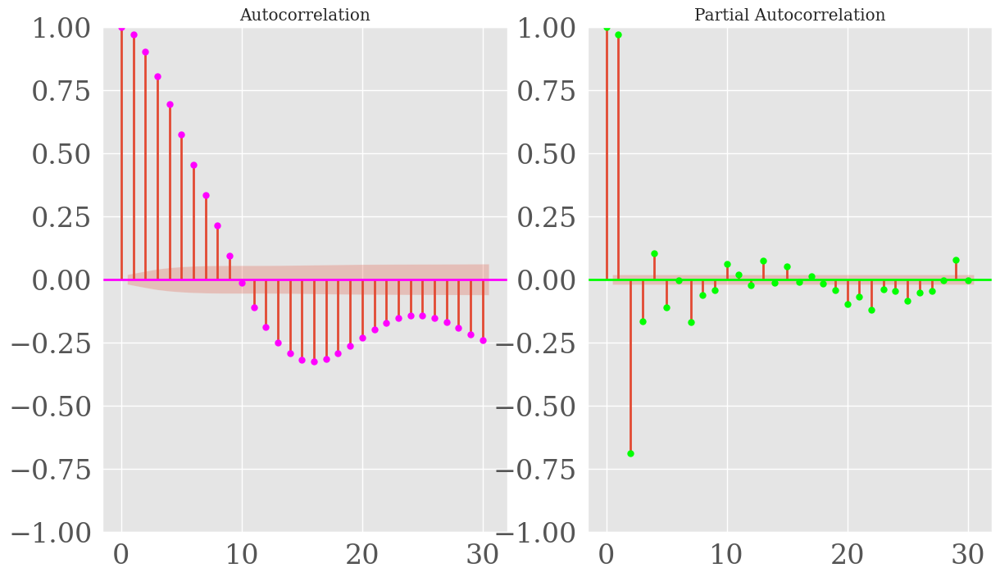

In [18]:
fig, axs = plt.subplots(nrows=1, ncols=2)

plot_acf(df["y"],  lags=30, ax=axs[0],color="fuchsia")
axs[0].set_title("Autocorrelation");

# Grafico
plot_pacf(df["y"],  lags=30, ax=axs[1],color="lime")
axs[1].set_title('Partial Autocorrelation')

Additive

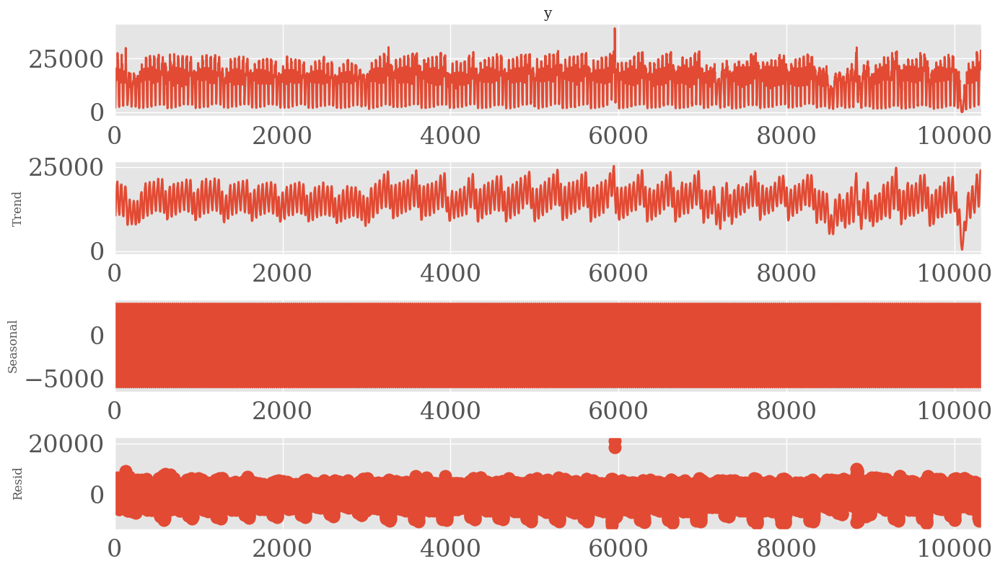

In [21]:
a = seasonal_decompose(df["y"], model = "additive", period=24).plot()

Multiplicative

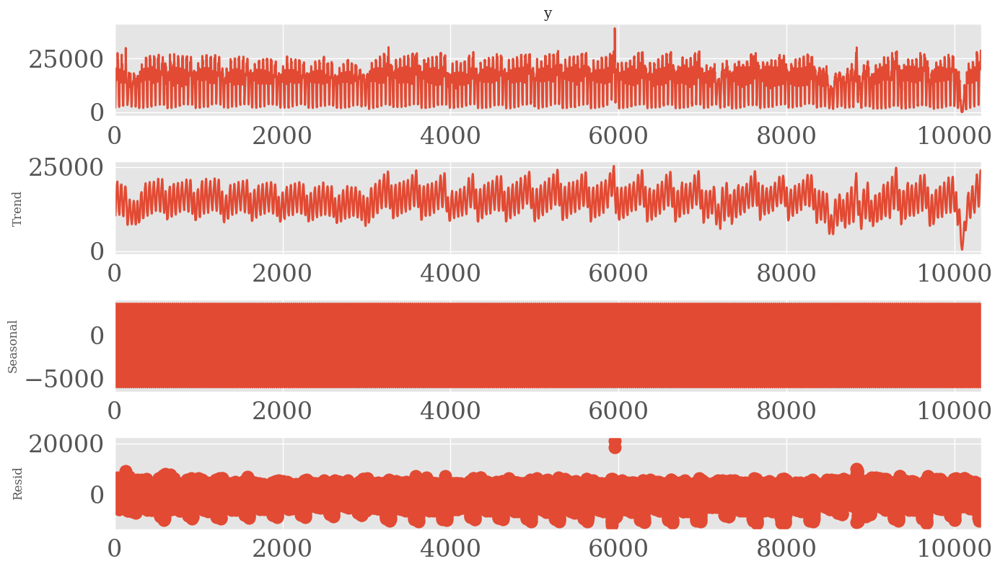

In [22]:
b = seasonal_decompose(df["y"], model = "Multiplicative", period=24).plot()

In [23]:
train = df[df.ds<='2015-01-21 13:30:00'] 
test = df[df.ds>'2015-01-21 13:30:00']
train.shape, test.shape

((9820, 3), (500, 3))

In [31]:
model1 = [xgb.XGBRegressor()]

mlf = MLForecast(
    models=model1,
    freq='30min', 
    target_transforms=[Differences([1])],
)
prep = mlf.preprocess(df)
prep

,ds,y,unique_id
1,2014-07-01 00:30:00,-2717.0,1
2,2014-07-01 01:00:00,-1917.0,1
3,2014-07-01 01:30:00,-1554.0,1
4,2014-07-01 02:00:00,-836.0,1
5,2014-07-01 02:30:00,-947.0,1
...,...,...,...
10315,2015-01-31 21:30:00,951.0,1
10316,2015-01-31 22:00:00,1051.0,1
10317,2015-01-31 22:30:00,1588.0,1
10318,2015-01-31 23:00:00,-718.0,1


Add features

In [33]:
mlf = MLForecast(
    models=model1,
    freq='30min',  
    lags=[1,24],
    target_transforms=[Differences([1])],
)

prep = mlf.preprocess(df)
prep

,ds,y,unique_id,lag1,lag24
25,2014-07-01 12:30:00,-22.0,1,445.0,-2717.0
26,2014-07-01 13:00:00,-708.0,1,-22.0,-1917.0
27,2014-07-01 13:30:00,1281.0,1,-708.0,-1554.0
28,2014-07-01 14:00:00,87.0,1,1281.0,-836.0
29,2014-07-01 14:30:00,1045.0,1,87.0,-947.0
...,...,...,...,...,...
10315,2015-01-31 21:30:00,951.0,1,428.0,4642.0
10316,2015-01-31 22:00:00,1051.0,1,951.0,-519.0
10317,2015-01-31 22:30:00,1588.0,1,1051.0,2411.0
10318,2015-01-31 23:00:00,-718.0,1,1588.0,214.0


In [34]:
prep.drop(columns=['unique_id', 'ds']).corr()['y']

y        1.000000
lag1     0.663082
lag24    0.155366
Name: y, dtype: float64

Lag transforms

In [35]:
mlf = MLForecast(
    models=model1,
    freq='30min',  
    lags=[1,24],
    lag_transforms={1: [ExpandingMean()], 24: [RollingMean(window_size=7)]},
    target_transforms=[Differences([1])],
)
prep = mlf.preprocess(df)
prep

,ds,y,unique_id,lag1,lag24,expanding_mean_lag1,rolling_mean_lag24_window_size7
31,2014-07-01 15:30:00,-836.0,1,-1211.0,-305.0,284.533325,-1254.285767
32,2014-07-01 16:00:00,-2316.0,1,-836.0,157.0,248.387100,-843.714294
33,2014-07-01 16:30:00,-1215.0,1,-2316.0,-63.0,168.250000,-578.857117
34,2014-07-01 17:00:00,2190.0,1,-1215.0,357.0,126.333336,-305.857147
35,2014-07-01 17:30:00,2322.0,1,2190.0,1849.0,187.029419,77.714287
...,...,...,...,...,...,...,...
10315,2015-01-31 21:30:00,951.0,1,428.0,4642.0,1.248303,2064.285645
10316,2015-01-31 22:00:00,1051.0,1,951.0,-519.0,1.340378,1873.428589
10317,2015-01-31 22:30:00,1588.0,1,1051.0,2411.0,1.442129,2179.000000
10318,2015-01-31 23:00:00,-718.0,1,1588.0,214.0,1.595910,1888.714233


In [37]:
mlf = MLForecast(
    models=model1,
    freq='30min', 
    lags=[1,24],
    lag_transforms={1: [ExpandingMean()], 24: [RollingMean(window_size=7)]},
    target_transforms=[Differences([1])],
    date_features=["year", "month", "day", "hour"]
)

prep = mlf.preprocess(df)
prep

,ds,y,unique_id,lag1,lag24,expanding_mean_lag1,rolling_mean_lag24_window_size7,year,month,day,hour
31,2014-07-01 15:30:00,-836.0,1,-1211.0,-305.0,284.533325,-1254.285767,2014,7,1,15
32,2014-07-01 16:00:00,-2316.0,1,-836.0,157.0,248.387100,-843.714294,2014,7,1,16
33,2014-07-01 16:30:00,-1215.0,1,-2316.0,-63.0,168.250000,-578.857117,2014,7,1,16
34,2014-07-01 17:00:00,2190.0,1,-1215.0,357.0,126.333336,-305.857147,2014,7,1,17
35,2014-07-01 17:30:00,2322.0,1,2190.0,1849.0,187.029419,77.714287,2014,7,1,17
...,...,...,...,...,...,...,...,...,...,...,...
10315,2015-01-31 21:30:00,951.0,1,428.0,4642.0,1.248303,2064.285645,2015,1,31,21
10316,2015-01-31 22:00:00,1051.0,1,951.0,-519.0,1.340378,1873.428589,2015,1,31,22
10317,2015-01-31 22:30:00,1588.0,1,1051.0,2411.0,1.442129,2179.000000,2015,1,31,22
10318,2015-01-31 23:00:00,-718.0,1,1588.0,214.0,1.595910,1888.714233,2015,1,31,23


Fit model

In [38]:
mlf.fit(
    df,  
    fitted=True, 
    prediction_intervals=PredictionIntervals(n_windows=5, h=30, method="conformal_distribution")
)

MLForecast(models=[XGBRegressor], freq=30min, lag_features=['lag1', 'lag24', 'expanding_mean_lag1', 'rolling_mean_lag24_window_size7'], date_features=['year', 'month', 'day', 'hour'], num_threads=1)

In [39]:
result = mlf.forecast_fitted_values()
result = result.set_index("unique_id")
result

,ds,y,XGBRegressor
unique_id,,,
1,2014-07-01 15:30:00,18544.0,18441.443359
1,2014-07-01 16:00:00,16228.0,16391.152344
1,2014-07-01 16:30:00,15013.0,15260.714844
1,2014-07-01 17:00:00,17203.0,17066.148438
1,2014-07-01 17:30:00,19525.0,19714.404297
...,...,...,...
1,2015-01-31 21:30:00,24670.0,24488.646484
1,2015-01-31 22:00:00,25721.0,25868.865234
1,2015-01-31 22:30:00,27309.0,27290.125000


Diagnostic

In [41]:
from statsmodels.stats.diagnostic import normal_ad
from scipy import stats


sw_result = stats.shapiro(result["XGBRegressor"])
ad_result = normal_ad(np.array(result["XGBRegressor"]), axis=0)
dag_result = stats.normaltest(result["XGBRegressor"], axis=0, nan_policy='propagate')

/home/eduard/mambaforge/envs/mix/lib/python3.9/site-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 10289.



In [45]:
sw_result, ad_result, dag_result

(ShapiroResult(statistic=0.9398618902609714, pvalue=2.0097518185418041e-53),
 (227.7972681571555, 0.0),
 NormaltestResult(statistic=1109.4327846767017, pvalue=1.2295092096534707e-241))

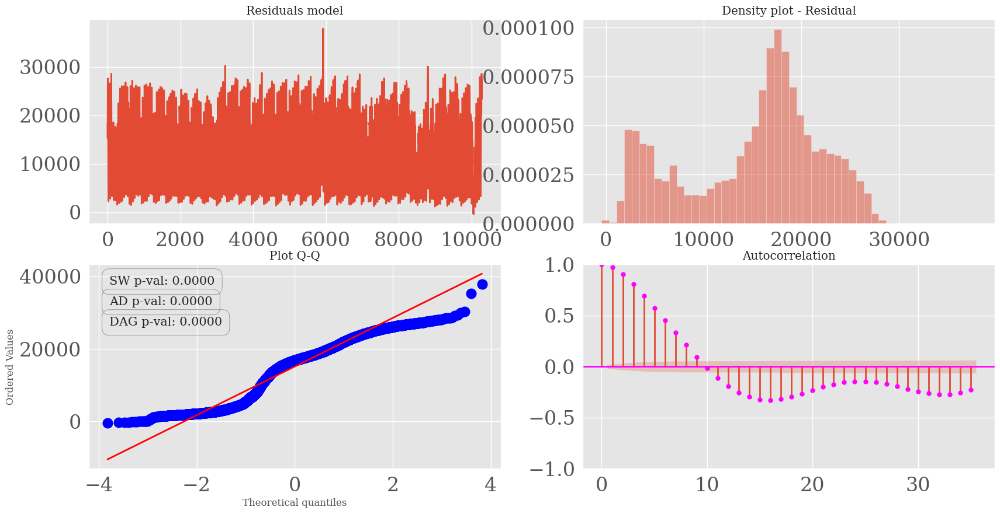

In [44]:
result=mlf.forecast_fitted_values()
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(20, 10))

# plot[1,1]
result["XGBRegressor"].plot(ax=axs[0,0])
axs[0,0].set_title("Residuals model");

# plot
axs[0,1].hist(result["XGBRegressor"], density=True,bins=50, alpha=0.5 )
axs[0,1].set_title("Density plot - Residual");

# plot
stats.probplot(result["XGBRegressor"], dist="norm", plot=axs[1,0])
axs[1,0].set_title('Plot Q-Q')
axs[1,0].annotate("SW p-val: {:.4f}".format(sw_result[1]), xy=(0.05,0.9), xycoords='axes fraction', fontsize=15,
            bbox=dict(boxstyle="round", fc="none", ec="gray", pad=0.6))

axs[1,0].annotate("AD p-val: {:.4f}".format(ad_result[1]), xy=(0.05,0.8), xycoords='axes fraction', fontsize=15,
            bbox=dict(boxstyle="round", fc="none", ec="gray", pad=0.6))

axs[1,0].annotate("DAG p-val: {:.4f}".format(dag_result[1]), xy=(0.05,0.7), xycoords='axes fraction', fontsize=15,
            bbox=dict(boxstyle="round", fc="none", ec="gray", pad=0.6))
# plot
plot_acf(result["XGBRegressor"],  lags=35, ax=axs[1,1],color="fuchsia")
axs[1,1].set_title("Autocorrelation");

Predict method with prediction intervals

In [47]:
forecast_df = mlf.predict(h=30, level=[80,95])
forecast_df.head()

,unique_id,ds,XGBRegressor,XGBRegressor-lo-95,XGBRegressor-lo-80,XGBRegressor-hi-80,XGBRegressor-hi-95
0,1,2015-02-01 00:00:00,26320.298828,25559.884241,25680.228369,26960.369287,27080.713416
1,1,2015-02-01 00:30:00,26446.472656,24130.429614,25195.461621,27697.483691,28762.515698
2,1,2015-02-01 01:00:00,24909.970703,23094.950537,23579.583398,26240.358008,26724.990869
3,1,2015-02-01 01:30:00,24405.402344,21548.628296,22006.662598,26804.142090,27262.176392
4,1,2015-02-01 02:00:00,22292.390625,20666.736963,21130.215430,23454.565820,23918.044287


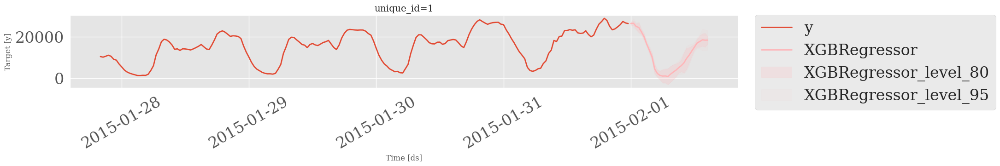

In [51]:
plot_series(df, forecast_df, level=[80,95], max_insample_length=200,engine="matplotlib")
